<a href="https://colab.research.google.com/github/Neruoy/Vision-based-robotic-grasping-system-using-deep-learning/blob/main/transfer_model_04_cornell.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Environment setup

In [1]:
!nvidia-smi

Fri Jun  4 20:19:16 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    29W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Import libraries

In [2]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models, optimizers, Sequential
import numpy as np
import math
import matplotlib.pyplot as plt
import os
import pickle
import copy
import cv2
import random
from google.colab import drive
from datetime import datetime
from sklearn.model_selection import train_test_split
import datetime
import matplotlib.pylab as plt
from PIL import Image, ImageDraw
import tensorflow_hub as hub
import tensorboard
from datetime import datetime
import math

## Mount google drive

In [3]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# Mount your Drive to the Colab VM.
# drive.mount('/content/drive',force_remount=True)
#path_data = '/content/drive/MyDrive/Colab Notebooks/Robot_Grasping_PolyU/cornell_grasping_dataset/'
#path_data= '/content/drive/MyDrive/Colab Notebooks/Robot_Grasping_PolyU/20210531_grasp_dataset/'
# path_data= '/content/drive/MyDrive/Colab Notebooks/Robot_Grasping_PolyU/grasp_share/Alan/20210531_grasp_dataset/'
path_data= '/content/drive/MyDrive/DLOD/grasp_share/data/cornell_grasping_dataset/'

## Check raw image data

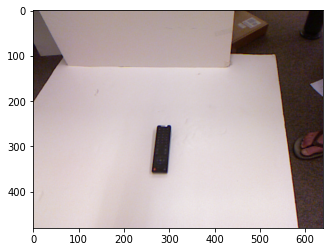

In [5]:
path_img= '/content/drive/MyDrive/DLOD/grasp_share/data/cornell_grasping_dataset/01/pcd0100r.png'
image = plt.imread(path_img)
plt.imshow(image)

In [6]:
(HEIGHT, WIDTH, CHANNELS) = image.shape

In [63]:
(HEIGHT, WIDTH, CHANNELS)

(480, 640, 3)

## Define utility functions

In [7]:
INPUT_SIZE = (224, 224, 3)
BATCH_SIZE = 32

In [82]:
def prepocess_img(img, input_size=INPUT_SIZE):
  input_img = tf.image.resize(img, size=[input_size[0], input_size[1]])
  input_img = tf.divide(input_img, 255.)
  return input_img

def invprepocess_img(img, w=WIDTH, h=HEIGHT):
  input_img = tf.image.resize(img, size=[h, w])
  return input_img

def prepocess_lab(lab, w=WIDTH, h=HEIGHT):
  scaler = tf.constant([w, h] * 4, dtype=tf.float32)
  normalize_lab = tf.divide(lab, scaler)
  return normalize_lab

def invprepocess_lab(lab, w=WIDTH, h=HEIGHT):
  scaler = tf.constant([w, h] * 4, dtype=tf.float32)
  invnormalize_lab = tf.multiply(lab, scaler)
  return invnormalize_lab

def draw_box(images, labs):
  imgs = copy.deepcopy(images)
  img_with_box = []
  for img, lab in zip(imgs, labs):
    pt = {}
    for j, i in enumerate(range(0, 8, 2)):
      pt[j + 1] = (int(lab[i:i + 1][0]), int(lab[i + 1:i + 2][0]))
    cv2.line(img, pt[1], pt[2], (0,0,255), 3)
    cv2.line(img, pt[2], pt[3], (0,0,255), 3)
    cv2.line(img, pt[3], pt[4], (0,0,255), 3)
    cv2.line(img, pt[4], pt[1], (0,0,255), 3)

    # matplotlib to display
    # img = img / 255.
    f = plt.figure(figsize=(12, 9))
    plt.axis(False)
    plt.imshow(img)

from tensorflow.python.framework.convert_to_constants import convert_variables_to_constants_v2
def convert_to_froze_graph(keras_model, model_name, output_folder):
    """
    Export keras model to frozen model.

    Args:
        keras_model (tensorflow.python.keras.models.Model):
        model_name (str): Model name for the file name.
        output_folder (str): Output folder for saving model.

    """
    full_model = tf.function(lambda x: keras_model(x))
    full_model = full_model.get_concrete_function(
        tf.TensorSpec(keras_model.inputs[0].shape, keras_model.inputs[0].dtype)
    )

    frozen_func = convert_variables_to_constants_v2(full_model)
    frozen_func.graph.as_graph_def()

    print(f"Model inputs: {frozen_func.inputs}")
    print(f"Model outputs: {frozen_func.outputs}")

    tf.io.write_graph(graph_or_graph_def=frozen_func.graph,
                      logdir=output_folder,
                      name=model_name,
                      as_text=False)

@tf.function
def label2box(lab):
  lab2 = tf.reshape(lab, [4, 2])
  max = tf.reduce_max(t_new, axis=0)
  min = tf.reduce_min(t_new, axis=0)
  x_max, y_max = max[0], max[1]
  x_min, y_min = min[0], min[1]
  return [y_min, x_min, y_max, x_max]

# Data Preprocessing

## Load stored pickle files

In [9]:
%%time

path= path_data

file = open(path+"images_raw",'rb')
_x_train = pickle.load(file)
file.close()

file = open(path+"labels_raw",'rb')
_y_train = pickle.load(file)
file.close()

label_2 =[]
for i in range(len(_y_train)):
  arr= _y_train[i][0:4]
  arr= arr.flatten()
  label_2.append(arr)
_y_train = np.array(label_2)

_x_train = np.asarray(_x_train)
_y_train = np.asarray(_y_train)

print(_x_train.shape, _y_train.shape, )

(885, 480, 640, 3) (885, 8)
CPU times: user 694 ms, sys: 7.48 s, total: 8.18 s
Wall time: 9.29 s


In [10]:
_y_train = _y_train.astype(np.float32)

In [11]:
NUM_IMAGES = _x_train.shape[0]

## Train, val, test split

In [12]:
BATCH_SIZE = 128
ratio = 1

x_train, x_test_full, y_train_pre, y_test_full = train_test_split(
    _x_train, _y_train, test_size=2 * ratio * BATCH_SIZE)

x_valid, x_test = x_test_full[:(ratio * BATCH_SIZE)], x_test_full[(ratio * BATCH_SIZE):]
y_valid_pre, y_test_pre = y_test_full[:(ratio * BATCH_SIZE)], y_test_full[(ratio * BATCH_SIZE):]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

CPU times: user 234 ms, sys: 3.97 s, total: 4.21 s
Wall time: 4.17 s


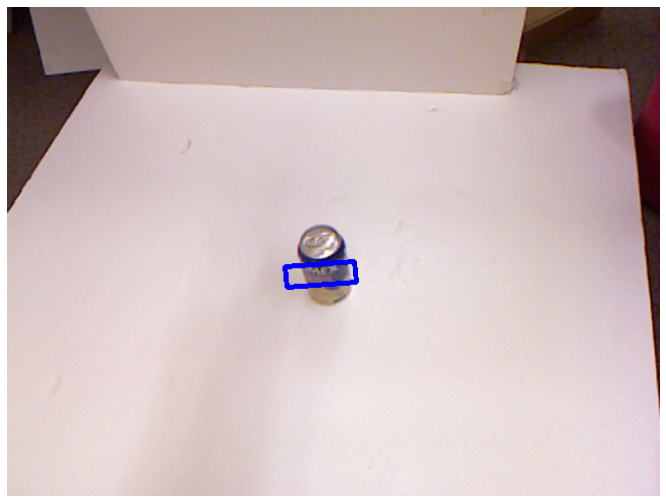

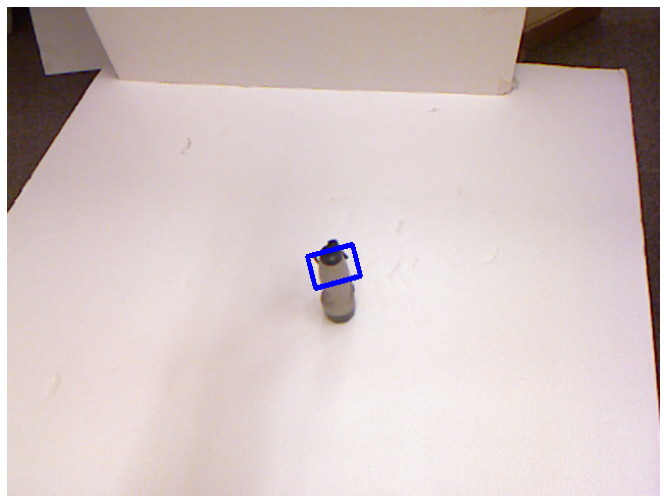

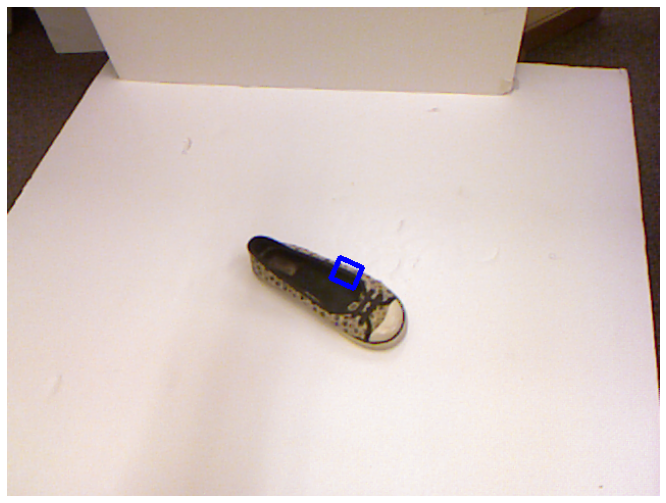

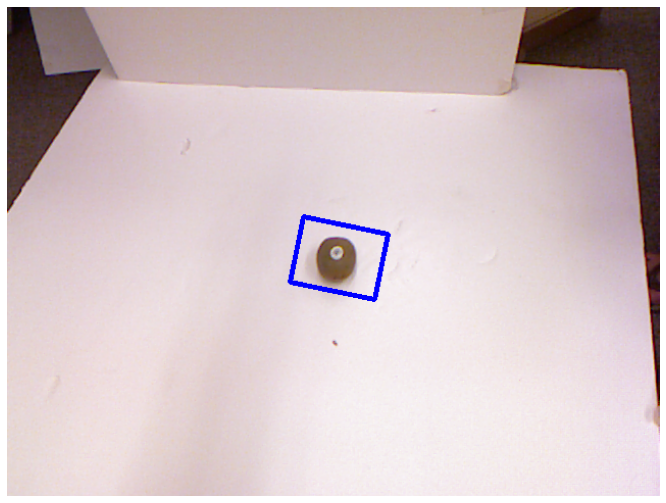

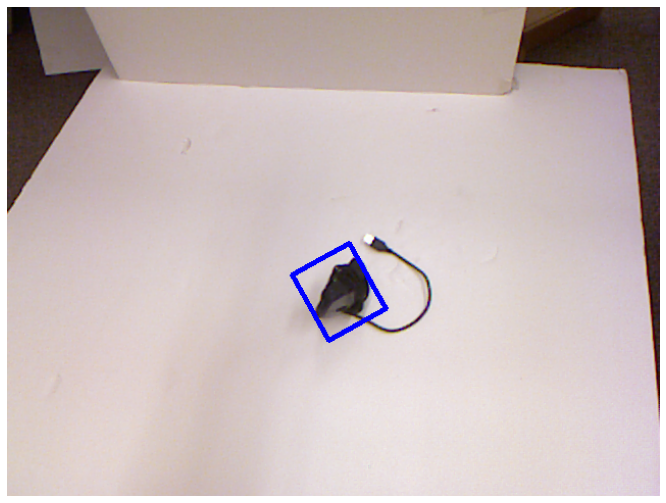

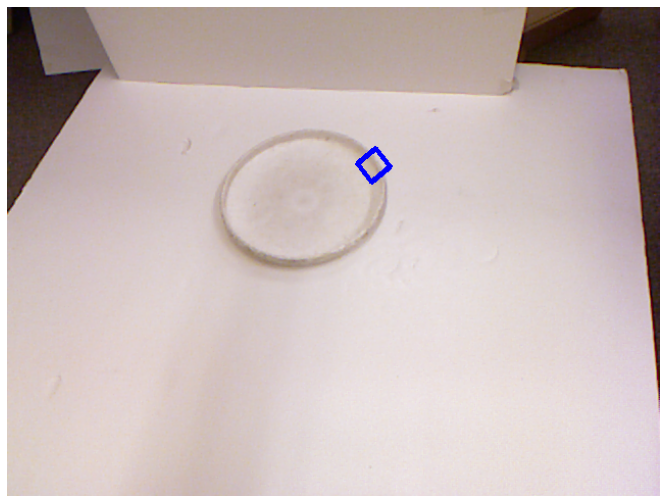

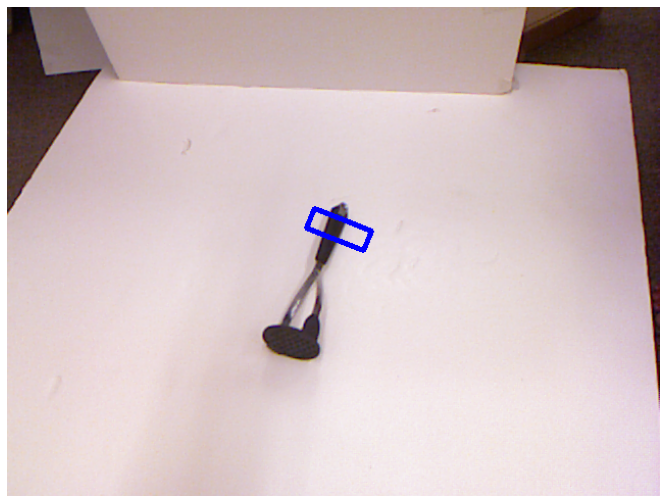

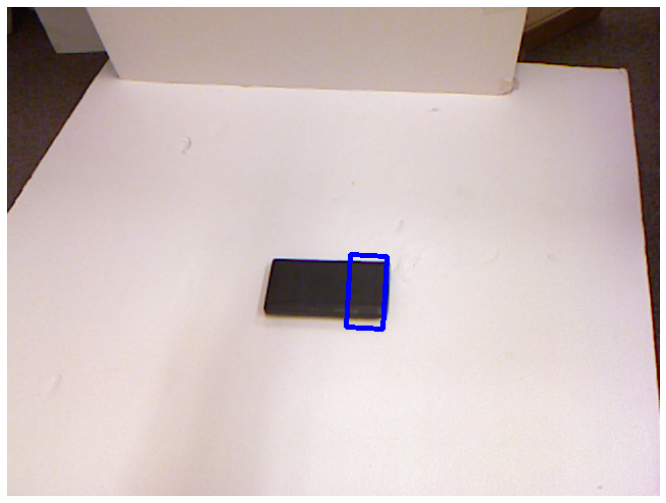

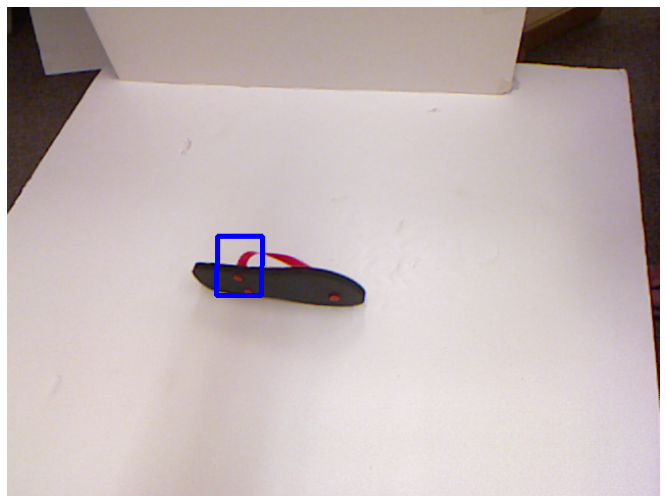

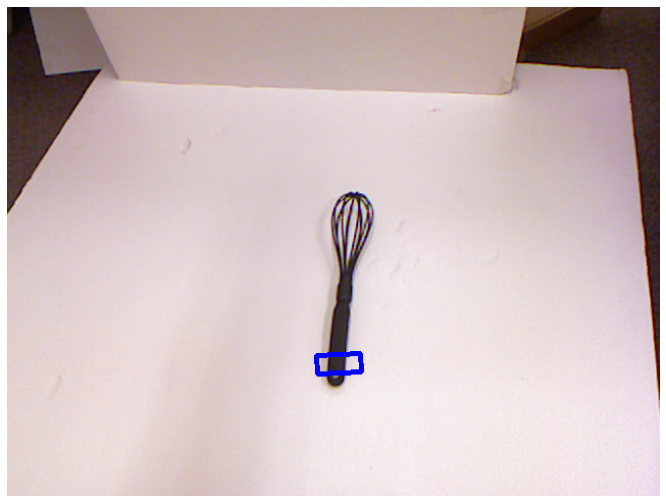

In [83]:
%%time
indx = np.arange(10)
imgs, labs = (x_valid / 255.)[indx], y_valid_pre[indx]
draw_box(imgs, labs)

## Normalize data and prepare dataset



In [14]:
AUTOTUNE = tf.data.AUTOTUNE

############################### TRAIN ###############################

x_train_ds_pre = tf.data.Dataset.from_tensor_slices(x_train)
x_train_ds = x_train_ds_pre.map(prepocess_img, num_parallel_calls=AUTOTUNE)
y_train_ds_pre = tf.data.Dataset.from_tensor_slices(y_train_pre)
y_train_ds = y_train_ds_pre.map(prepocess_lab, num_parallel_calls=AUTOTUNE)
train_ds = tf.data.Dataset.zip((x_train_ds, y_train_ds)).shuffle(NUM_IMAGES).batch(BATCH_SIZE)
train_ds.prefetch(AUTOTUNE)

############################### VALID ###############################

x_valid_ds_pre = tf.data.Dataset.from_tensor_slices(x_valid)
x_valid_ds = x_valid_ds_pre.map(prepocess_img, num_parallel_calls=AUTOTUNE)
y_valid_ds_pre = tf.data.Dataset.from_tensor_slices(y_valid_pre)
y_valid_ds = y_valid_ds_pre.map(prepocess_lab, num_parallel_calls=AUTOTUNE)
valid_ds = tf.data.Dataset.zip((x_valid_ds, y_valid_ds)).shuffle(NUM_IMAGES).batch(BATCH_SIZE)
valid_ds.prefetch(AUTOTUNE)

############################### TEST ###############################

x_test_ds_pre = tf.data.Dataset.from_tensor_slices(x_test)
x_test_ds = x_test_ds_pre.map(prepocess_img, num_parallel_calls=AUTOTUNE)
y_test_ds_pre = tf.data.Dataset.from_tensor_slices(y_test_pre)
y_test_ds = y_test_ds_pre.map(prepocess_lab, num_parallel_calls=AUTOTUNE)
test_ds = tf.data.Dataset.zip((x_test_ds, y_test_ds)).shuffle(NUM_IMAGES).batch(BATCH_SIZE)
test_ds.prefetch(AUTOTUNE)

<PrefetchDataset shapes: ((None, 224, 224, 3), (None, 8)), types: (tf.float32, tf.float32)>

# Model construction

## Load pretrained model

In [15]:

def create_model():
  OUTPUT_SIZE =8

  base_model = tf.keras.applications.vgg19.VGG19(input_shape=INPUT_SIZE, include_top=False, weights='imagenet')
  #base_model = tf.keras.applications.InceptionResNetV2(input_shape=(HEIGHT, WIDTH, NUM_CHANNELS), weights='imagenet', include_top=False)
  #base_model = tf.keras.applications.ResNet50V2(input_shape=(HEIGHT, WIDTH, NUM_CHANNELS), weights='imagenet', include_top=False)
  #base_model = tf.keras.applications.ResNet152V2(input_shape=(HEIGHT, WIDTH, NUM_CHANNELS), weights='imagenet', include_top=False)
  #base_model = tf.keras.applications.MobileNetV3Small(input_shape=(HEIGHT, WIDTH, NUM_CHANNELS), weights='imagenet', include_top=False)
  #base_model = tf.keras.applications.DenseNet121(input_shape=(HEIGHT, WIDTH, NUM_CHANNELS), include_top=False, weights='imagenet')

  base_model.trainable = False
  x = base_model.output
  x = tf.keras.layers.GlobalAveragePooling2D()(x)
  x = tf.keras.layers.Dense(4096, kernel_initializer='he_normal')(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.ELU()(x)
  x = tf.keras.layers.Dropout(rate=0.2)(x)
  x = tf.keras.layers.Dense(1024, kernel_initializer='he_normal')(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.ELU()(x)
  x = tf.keras.layers.Dropout(rate=0.2)(x)
  x = tf.keras.layers.Dense(256, kernel_initializer='he_normal')(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.ELU()(x)
  # x = tf.keras.layers.Dropout(rate=0.2)(x)
  outputs = tf.keras.layers.Dense(8)(x)

  model = models.Model(inputs=base_model.input, outputs=outputs)
  #print(base_model.summary())
  return model

model = create_model()

In [16]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

# Model Training

## Customize loss function

### Huber Loss

In [17]:
def create_huber(threshold=0.5):
  def huber_fn(y_true, y_pred):
    error = y_true - y_pred
    is_small_error = tf.abs(error) < threshold
    squared_loss = tf.square(error) / 2
    linear_loss = threshold * tf.abs(error) - threshold**2 / 2
    return tf.where(is_small_error, squared_loss, linear_loss)
  return huber_fn

### GIoU loss

In [18]:
def giouLoss(y_true, y_pred):
  '''
  Args:
    y_true: true targets tensor. The coordinates of the each bounding
        box in boxes are encoded as [y_min, x_min, y_max, x_max].
    y_pred: predictions tensor. The coordinates of the each bounding
        box in boxes are encoded as [y_min, x_min, y_max, x_max].
  '''
  giloss = tfa.losses.giou_loss(label2box(y_true), label2box(y_pred))
  return giloss

## Train the model

In [19]:
n_epochs = 2000
initial_lr = 0.001

# Clear any logs from previous runs
!rm -rf ./logs/
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_cb = tf.keras.callbacks.TensorBoard(log_dir=logdir)

checkpoint_cb = tf.keras.callbacks.ModelCheckpoint('vgg19_tf.h5', save_best_only=True)
early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=100, restore_best_weights=True)
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=50)

optimizer = tf.keras.optimizers.Nadam(learning_rate=initial_lr)
model.compile(
    optimizer=optimizer,
    # loss=giouLoss,
    # loss=create_huber(),
    loss='mse'
    )

model.fit(train_ds,
          epochs=n_epochs,
          validation_data=valid_ds,
          callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_cb])

Epoch 1/2000
5/5 [==============================] - 31s 3s/step - loss: 3.6306 - val_loss: 0.4053
Epoch 2/2000
5/5 [==============================] - 3s 539ms/step - loss: 0.3123 - val_loss: 0.1653
Epoch 3/2000
5/5 [==============================] - 3s 512ms/step - loss: 0.2034 - val_loss: 0.1115
Epoch 4/2000
5/5 [==============================] - 3s 531ms/step - loss: 0.1422 - val_loss: 0.0813
Epoch 5/2000
5/5 [==============================] - 3s 535ms/step - loss: 0.1057 - val_loss: 0.0488
Epoch 6/2000
5/5 [==============================] - 3s 535ms/step - loss: 0.0776 - val_loss: 0.0497
Epoch 7/2000
5/5 [==============================] - 3s 523ms/step - loss: 0.0611 - val_loss: 0.0421
Epoch 8/2000
5/5 [==============================] - 3s 539ms/step - loss: 0.0532 - val_loss: 0.0450
Epoch 9/2000
5/5 [==============================] - 3s 535ms/step - loss: 0.0478 - val_loss: 0.0317
Epoch 10/2000
5/5 [==============================] - 3s 533ms/step - loss: 0.0466 - val_loss: 0.0335
E

In [20]:
# Load the TensorBoard notebook extension.
#!kill 2092
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

## Save the model

In [21]:
raise Exception('STOP HERE')

Exception: ignored

In [30]:
%%time
# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%Y_%m_%d_%H_%M_%S")
folder = '/content/drive/MyDrive/DLOD/grasp_share/Youren/cornell'
save_path = folder + '/model_' + dt_string + '/'
tf.saved_model.save(model, save_path)

# for .om file
convert_to_froze_graph(keras_model= model, 
                       model_name='pb2OMfile.pb', 
                       output_folder=save_path)


FOR DEVS: If you are overwriting _tracking_metadata in your class, this property has been used to save metadata in the SavedModel. The metadta field will be deprecated soon, so please move the metadata to a different file.
INFO:tensorflow:Assets written to: /content/drive/MyDrive/DLOD/grasp_share/Youren/cornell/model_2021_06_04_20_46_09/assets
Model inputs: [<tf.Tensor 'x:0' shape=(None, 224, 224, 3) dtype=float32>]
Model outputs: [<tf.Tensor 'Identity:0' shape=(None, 8) dtype=float32>]
CPU times: user 4.45 s, sys: 320 ms, total: 4.77 s
Wall time: 5.15 s


In [38]:
temp_path = '/content/models/' + dt_string + '.h5'
model.save(temp_path)

# Model testing

## Load saved model

In [39]:
final_model = tf.keras.models.load_model(temp_path)

## Run model with train dataset

In [87]:
train_outputs = final_model.predict(train_ds.map(lambda X, y: X))
train_outputs.shape

(629, 8)

In [93]:
train_pred = [invprepocess_lab(_output) for _output in train_outputs]

In [94]:
train_set = train_ds.unbatch()
train_imgs = [invprepocess_img(img).numpy() for img, lab in train_set]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

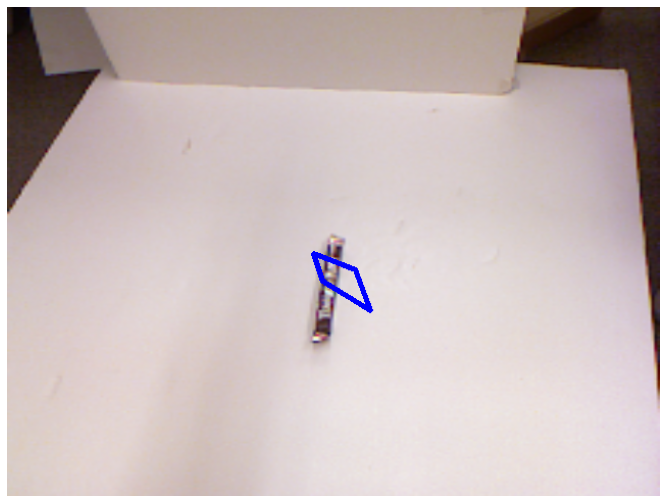

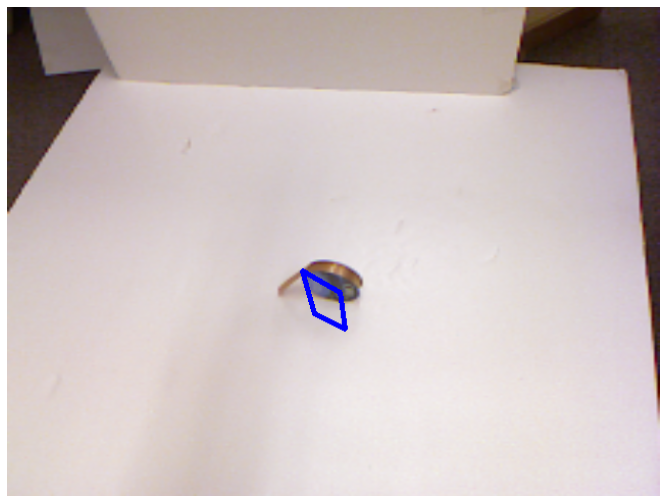

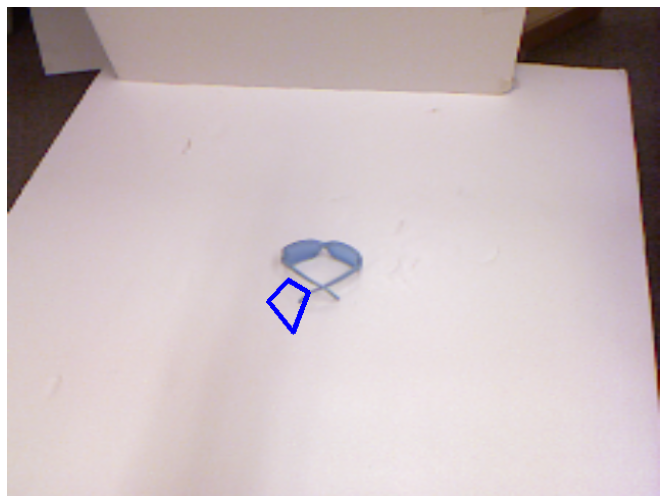

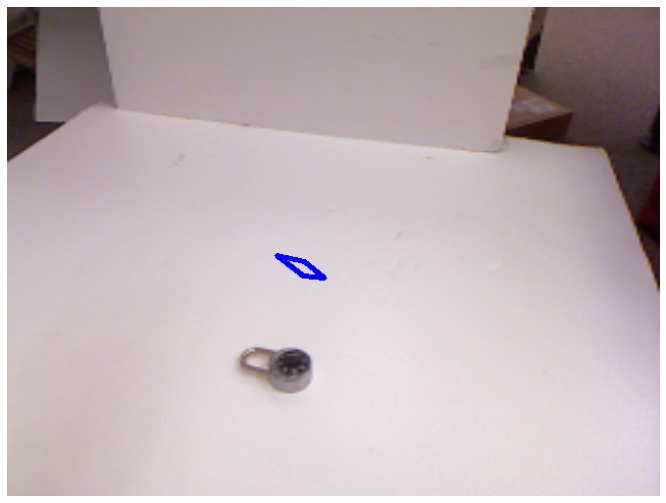

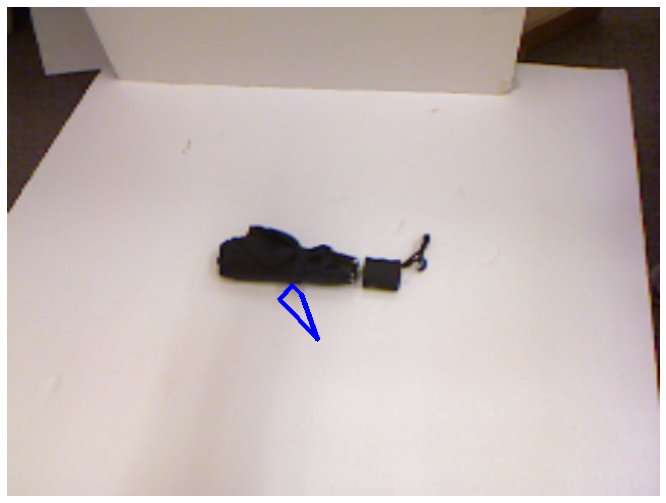

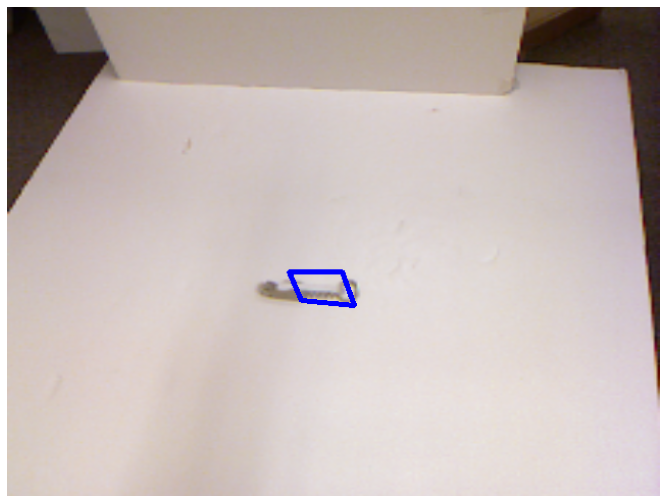

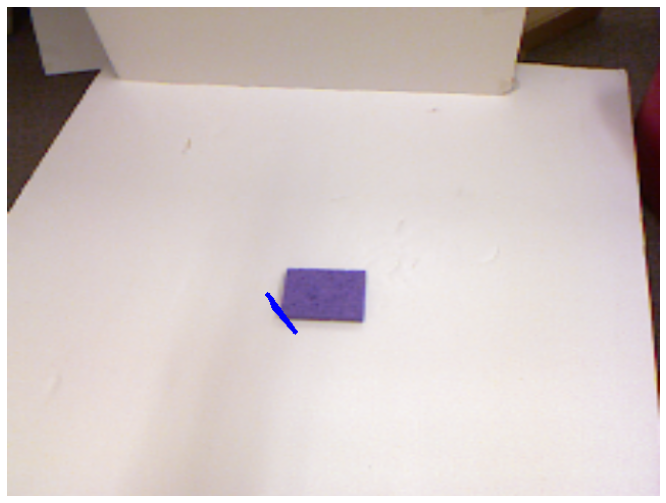

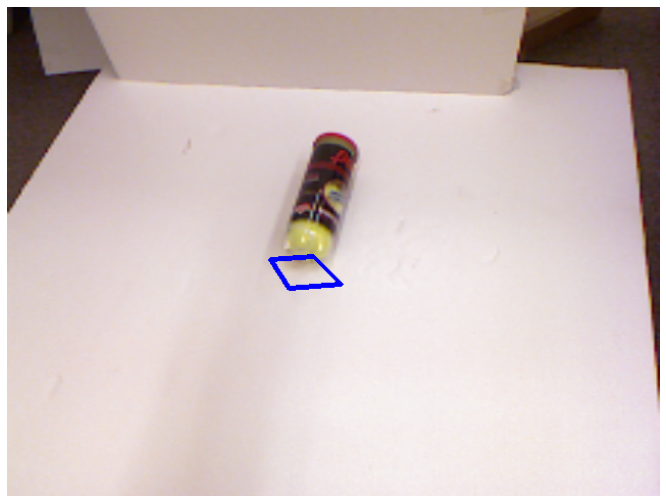

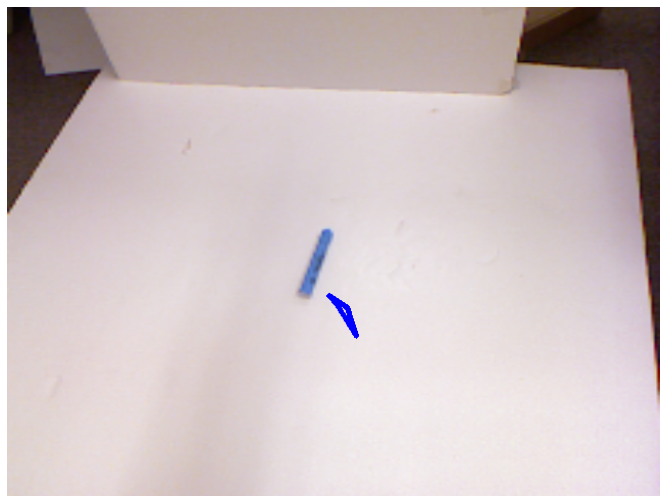

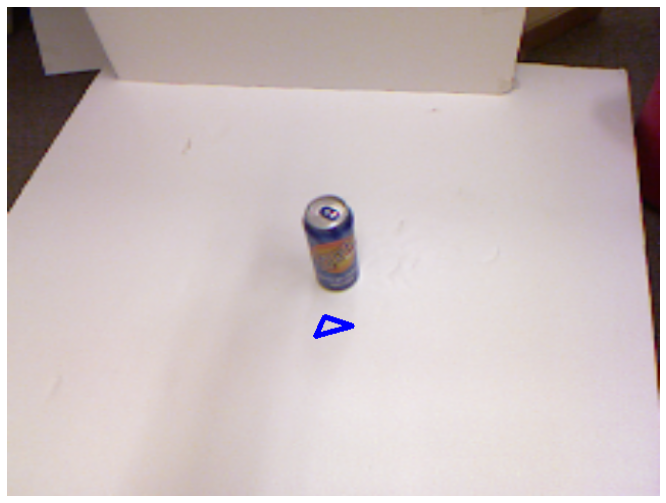

In [95]:
index = 10
imgs, labs = train_imgs[:index], train_pred[:index]
draw_box(imgs, labs)

## Run model with val dataset

## Run model with test dataset